In [ ]:
#TODO insert only needed package

import matplotlib.pyplot as plt # plotting library
import numpy as np # this module is useful to work with numerical arrays
import pandas as pd # this module is useful to work with tabular data
import random # this module will be used to select random samples from a collection
import os # this module will be used just to create directories in the local filesystem
from tqdm import tqdm # this module is useful to plot progress bars

import torch
import torchvision
from torchvision.transforms import Compose, ToTensor
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
from torch import nn

from fastai.data.external import untar_data,URLs
from fastai.data.transforms import get_image_files
from fastai.data.core import DataLoaders
import PIL

import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb
from IPython import display

import torch
from torch import nn, optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader

###DATASET CREATION

In [ ]:
path = untar_data(URLs.COCO_SAMPLE) 
coco_path = str(path) + "/train_sample" 

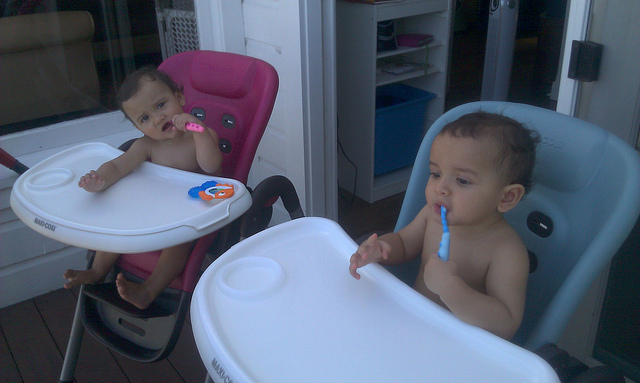

In [ ]:
dataset = get_image_files(coco_path)   
img = PIL.Image.open(dataset[1])
img

In [ ]:
print("INFO DATASET:")
print("Lunghezza: ", len(dataset))
print("Dimensioni immagini: ", img.size)

INFO DATASET:
Lunghezza:  21837
Dimensioni immagini:  (640, 383)


In [ ]:
'''
@param fname image file name in the dataset
@param size size for the final image after resizing
@return Tensor representation of the image
'''
def open_resize_image(fname, size=256): 
    img = PIL.Image.open(fname)
    img = img.resize((size, size))
    t = torch.Tensor(np.array(img))
    return t.permute(2,0,1).float()/255.0

In [ ]:
open_resize_image(dataset[0]).shape

torch.Size([3, 256, 256])

In [ ]:
paths = glob.glob(coco_path+"/*.jpg")                                # paths is a list with all image files names of the COCO dataset
np.random.seed(123)                                                  # Seeding for reproducible results
paths_subset = np.random.choice(paths, 10000, replace=False)         # Randomly choosing 10,000 images (image file names) from the list
rand_idxs = np.random.permutation(10000)                             # Shuffling the indexes
train_idxs = rand_idxs[:8000]                                        # Using first 8000 images for training
test_idxs = rand_idxs[8000:]                                         # Using last 2000 images for testing
train_paths = paths_subset[train_idxs]                               # Array with all the image files names for the training
test_paths = paths_subset[test_idxs]                                   # Array with all the image files names for the validation
print(len(train_paths), len(test_paths))

8000 2000


In [ ]:
SIZE= 256
class CustomDataset(Dataset):

    def __init__(self, paths, transform, training_mode=True):
        self.paths = paths
        self.size = SIZE
        self.training_mode = training_mode

        if training_mode:
          self.transform = transform
        else:
          #simple resize to the SIZE x SIZE dimensions
          self.transform = Compose([
              transforms.Resize((SIZE,SIZE), Image.BICUBIC),
          ])

    def __getitem__(self, index):
        #open the image as an RGB image and apply the correct transformations and transform to numpy array
        img = Image.open(self.paths[index]).convert("RGB")
        img = self.transform(img)
        img = np.array(img)

        #converting RGB to L*a*b color space used for the task and then to a tensor
        img_lab = rgb2lab(img).astype("float32")
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1
        
        return {'L': L, 'ab': ab}
        
    def __len__(self): 
      return len(self.paths)
 


In [ ]:
#define the train, validation and test dataset and the batch size
batch_size = 16

train_transform = transforms.Compose([
     transforms.Resize((SIZE,SIZE), Image.BICUBIC),
])

train_dataset =  CustomDataset(train_paths, train_transform, training_mode = True)
test_dataset =  CustomDataset(test_paths, transform = None, training_mode = False)
#test_dataset =  ImageDataset("./", "test", ToTensor())

train_dataloader = DataLoader(train_dataset, batch_size, shuffle=True, num_workers=os.cpu_count())
test_dataloader = DataLoader(test_dataset, batch_size, shuffle=False, num_workers=os.cpu_count())

/usr/local/lib/python3.8/dist-packages/torchvision/transforms/transforms.py:329: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  warnings.warn(


In [ ]:
data = next(iter(train_dataloader))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dataloader), len(test_dataloader))
type(data['L'])

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])
500 125


torch.Tensor

###PATCH DISCRIMINATOR MODEL DEFINITION AND INITIALIZATION

In [ ]:
import torch
import torch.nn as nn

class ConvBNLeakyRelu(nn.Module):
  def __init__(self, in_ch, out_ch, kernel_size=(4,4), stride=(2,2), padding=(1,1)):
    super().__init__()
    self.conv1 = nn.Conv2d(in_ch, out_ch, kernel_size, stride, padding, bias=False)
    self.bn1 = nn.BatchNorm2d(out_ch, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    self.relu = nn.LeakyReLU(negative_slope=0.2, inplace=True)

  def forward(self,inputs):
    x = self.conv1(inputs)
    x = self.bn1(x)
    x = self.relu(x)
    return x

class ConvLeakyRelu(nn.Module):
  def __init__(self, in_ch, out_ch):
    super().__init__()
    self.conv1 = nn.Conv2d(in_ch, out_ch, kernel_size=(4,4), stride=(2,2), padding=(1,1))
    self.relu = nn.LeakyReLU(negative_slope=0.2, inplace=True)

  def forward(self,inputs):
    x = self.conv1(inputs)
    x = self.relu(x)
    return x

class PatchDiscriminator(nn.Module):
  def __init__(self):
    super().__init__()
    self.model = nn.Sequential(
        ConvLeakyRelu(3,64),
        ConvBNLeakyRelu(64,128),
        ConvBNLeakyRelu(128,256),
        ConvBNLeakyRelu(256,512, stride=(1,1)),
        nn.Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
    )

  def forward(self, inputs):
    return self.model(inputs)

In [ ]:
#param: model that has to be initialized
#param: init, how to initialize the weights (xavier or norm)
def initialize_weights(model, init="normal"):
    classname = model.__class__.__name__
    if classname.find('Conv2d') != -1:
        if(init=="xavier"): 
          nn.init.xavier_uniform_(model.weight.data)
        if(init=="normal"):
          nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm2d') != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.2)
        nn.init.constant_(model.bias.data, 0)

In [ ]:
'''d = PatchDiscriminator()
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = d(dummy_input)
print(out.shape)

g = Unet();
dummy_input = torch.randn(16, 1, 256, 256) # batch_size, channels, size, size
out = g(dummy_input)
print(out.shape)'''


'd = PatchDiscriminator()\ndummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size\nout = d(dummy_input)\nprint(out.shape)\n\ng = Unet();\ndummy_input = torch.randn(16, 1, 256, 256) # batch_size, channels, size, size\nout = g(dummy_input)\nprint(out.shape)'

In [ ]:
#d.apply(initialize_weights)
#g.apply(initialize_weights)

In [ ]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.generator.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.generator.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def print_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

def save_losses(loss_meter_dict, epoch, path_losses):
    with open(path_losses, 'a') as file:
      file.write("---------------------------")
      file.write(f"Epoch: {epoch}\n")
      for loss_name, loss_meter in loss_meter_dict.items():
        file.write(f"{loss_name}: {loss_meter.avg:.5f}\n")


### UNET WITH RESNET18 BACKBONE

In [ ]:
# pip install fastai==2.4
from fastai.vision.learner import create_body
from torchvision.models import resnet18
from fastai.vision.models.unet import DynamicUnet

In [ ]:
def build_res_unet(n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    body = create_body(resnet18(), pretrained=True, n_in=n_input, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G

build_res_unet()

DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (1): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05

In [ ]:
def pretrain_generator(net_G, train_dl, opt, criterion, epochs):
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):
            L, ab = data['L'].to("cuda"), data['ab'].to("cuda")
            preds = net_G(L)
            loss = criterion(preds, ab)
            opt.zero_grad()
            loss.backward()
            opt.step()
            
            loss_meter.update(loss.item(), L.size(0))
            
        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")
        torch.save(net_G.state_dict(), "res18-unet.pt")

net_G = build_res_unet(n_input=1, n_output=2, size=256)
opt = optim.Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()        
pretrain_generator(net_G, train_dataloader, opt, criterion, 5)


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 1/5
L1 Loss: 0.08653


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 2/5
L1 Loss: 0.08307


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 3/5
L1 Loss: 0.08259


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 4/5
L1 Loss: 0.08249


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 5/5
L1 Loss: 0.08225


RuntimeError: ignored

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
torch.save(net_G.state_dict(), '/content/gdrive/MyDrive/weights/res18-unet.pt')

Mounted at /content/gdrive


###TRAINING TEST


In [ ]:
class GANLoss(nn.Module):

    #param loss: loss that we want to use
    def __init__(self, loss):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(1.0))
        self.register_buffer('fake_label', torch.tensor(0.0))
        self.loss = loss
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [ ]:
class MainModel(nn.Module):

    def __init__(self, net_G, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        #setting the device to cuda or cpu
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        #create the Unet, initialize its weights and move it to the device
        self.generator = net_G
        self.generator.apply(initialize_weights)
        self.generator.to(self.device)

        #create the PatchDiscriminator, initialize its weights and move it to the device
        self.discriminator = PatchDiscriminator()
        self.discriminator.apply(initialize_weights)
        self.discriminator.to(self.device)

        #define the losses
        self.GANcriterion = GANLoss(loss = nn.BCEWithLogitsLoss()).to(self.device)
        self.L1criterion = nn.L1Loss()

        #setting up the optimizer for discriminator and generator training
        self.generator_optimizer = optim.Adam(self.generator.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.discriminator_optimizer = optim.Adam(self.discriminator.parameters(), lr=lr_D, betas=(beta1, beta2))
        
    def setup_input(self, data):
        #setting data for training: divide the L and ab channels and move it to the device
        self.L = data['L'].to("cuda")
        self.ab = data['ab'].to("cuda")
        
    def forward(self):
        self.fake_color = self.generator(self.L)
    
    def backward_D(self):
        #create a batch of fake colored images and obtain the discriminator predictions
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.discriminator(fake_image.detach())

        #compute the discriminator loss for labeling fake samples as true
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        
        #retrieve a batch of real colored images and obtain the discriminator predictions
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.discriminator(real_image)

        #compute the discriminator loss for labeling true samples as fake
        self.loss_D_real = self.GANcriterion(real_preds, True)

        #compute a simple mean of the two losses and use is for the training of the discriminator
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self):
        #generate a fake image and obtain the discriminator labels
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.discriminator(fake_image)

        #calculate the generator loss as a simple mean of the Gan loss and the L1 loss
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        #generate a fake colored image with the generator and train it
        self.forward()
        self.discriminator.train()
        for p in self.discriminator.parameters():
            p.requires_grad = True 
        self.discriminator_optimizer.zero_grad()
        self.backward_D()
        self.discriminator_optimizer.step()
        
        self.generator.train()
        for p in self.discriminator.parameters():
            p.requires_grad = False 
        self.generator_optimizer.zero_grad()
        self.backward_G()
        self.generator_optimizer.step()

    #param: path_g where to save the generator parameters
    #param: path_d where to save the discriminator parameters
    #param: path_go where to save the generator optimizer parameters
    #param: path_do where to save the discriminator optimizer parameters
    def save_model_and_optimizers_state(self, path_g, path_d, path_go, path_do):
        torch.save(self.generator.state_dict(), path_g)
        torch.save(self.discriminator.state_dict(), path_d)
        torch.save(self.discriminator_optimizer.state_dict(), path_do)
        torch.save(self.generator_optimizer.state_dict(), path_go)

    #param: path_g from where to load the generator parameters
    #param: path_d from where to load the discriminator parameters
    #param: path_go from where to load the generator optimizer parameters
    #param: path_do from where to load the discriminator optimizer parameters
    def load_model_and_optimizers_state(self, path_g, path_d, path_go, path_do):
        self.generator.load_state_dict(torch.load(path_g))
        self.discriminator.load_state_dict(torch.load(path_d))
        self.discriminator_optimizer.load_state_dict(torch.load(path_do))
        self.generator_optimizer.load_state_dict(torch.load(path_go))

#### Utilities functions 

In [ ]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.generator.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.generator.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def print_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

def save_losses(loss_meter_dict, epoch, path_losses):
    with open(path_losses, 'a') as file:
      file.write("---------------------------")
      file.write(f"Epoch: {epoch}\n")
      for loss_name, loss_meter in loss_meter_dict.items():
        file.write(f"{loss_name}: {loss_meter.avg:.5f}\n")


#### Training function

In [ ]:
#param: model that must be trained
#param: train_dl train dataloader 
#param: epochs number of training epochs
#param: path_g where to save the generator parameters
#param: path_d where to save the discriminator parameters
#param: path_go where to save the generator optimizer parameters
#param: path_do where to save the discriminator optimizer parameters
#param: path_losses where to save the model losses
def train_model(model, train_dl, epochs, path_g, path_d, path_go, path_do, path_losses):
    data = next(iter(test_dataloader))         # getting a batch for visualizing the model output after fixed intervals
    #print("Recovering weights and status")
    #model.load_model_and_optimizers_state(path_g, path_d, path_go, path_do)
    for e in range(epochs):
        torch.cuda.empty_cache()
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):           
            model.setup_input(data)            # load the batch and separate the L and ab channels   
            model.optimize()                   
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % 200 == 0:                   # every 200 batch visualize the progress in the loss functions and in the images generated
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                print_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs
        #at the end of the epoch save the losses
        save_losses(loss_meter_dict, e, path_losses)
        #at the end of the epoch we save the models parameters and the optimizers states
        model.save_model_and_optimizers_state(path_g, path_d, path_go, path_do)

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 1/100
Iteration 200/500
loss_D_fake: 0.38208
loss_D_real: 0.38137
loss_D: 0.38173
loss_G_GAN: 2.21283
loss_G_L1: 9.60988
loss_G: 11.82271


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


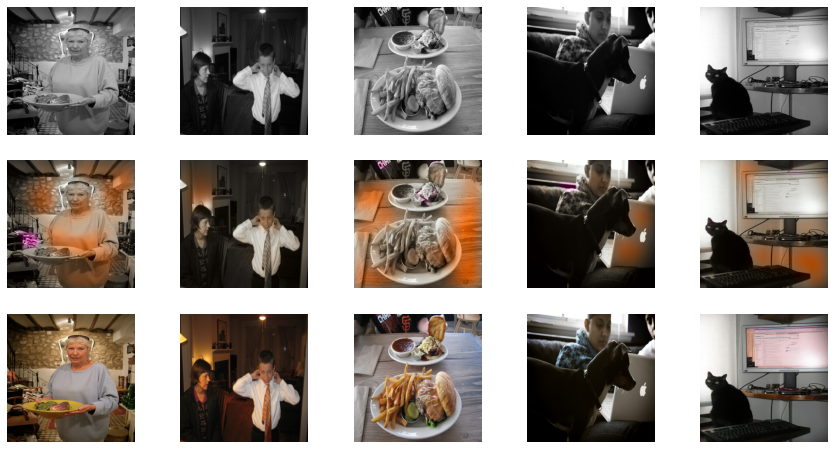


Epoch 1/100
Iteration 400/500
loss_D_fake: 0.40923
loss_D_real: 0.41193
loss_D: 0.41058
loss_G_GAN: 2.00587
loss_G_L1: 10.03087
loss_G: 12.03674


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


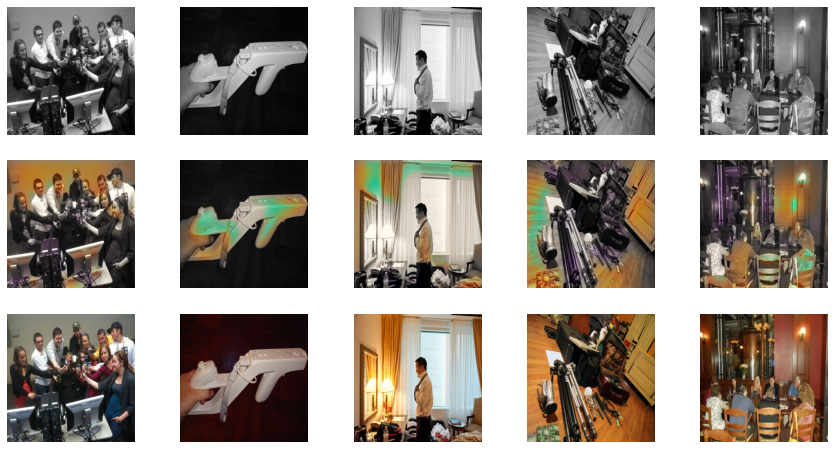

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 2/100
Iteration 200/500
loss_D_fake: 0.48074
loss_D_real: 0.51129
loss_D: 0.49602
loss_G_GAN: 1.48394
loss_G_L1: 10.83416
loss_G: 12.31809


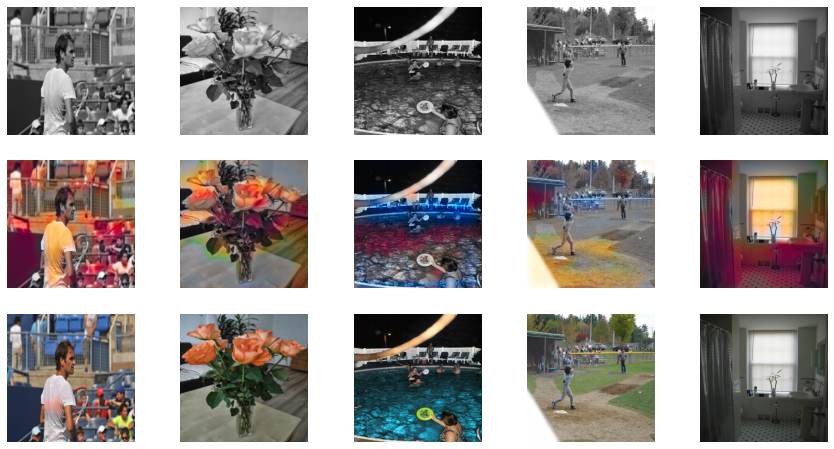


Epoch 2/100
Iteration 400/500
loss_D_fake: 0.48912
loss_D_real: 0.54240
loss_D: 0.51576
loss_G_GAN: 1.41720
loss_G_L1: 10.77727
loss_G: 12.19447


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


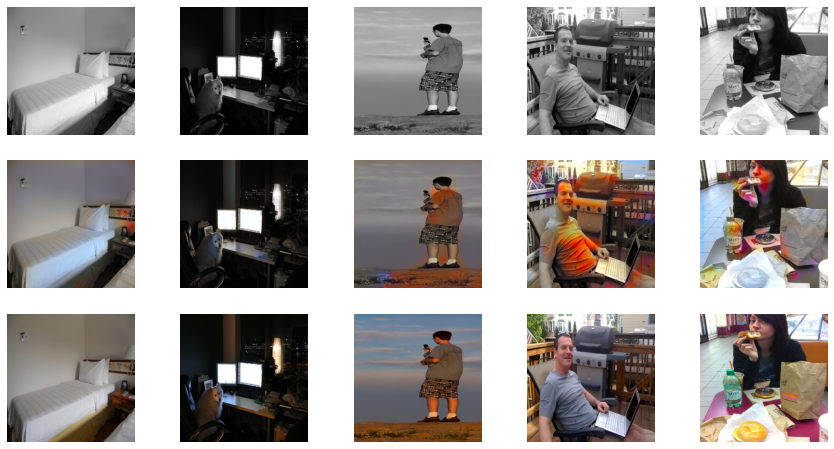

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 3/100
Iteration 200/500
loss_D_fake: 0.49406
loss_D_real: 0.51871
loss_D: 0.50638
loss_G_GAN: 1.43416
loss_G_L1: 10.90279
loss_G: 12.33695


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 175 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1485 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


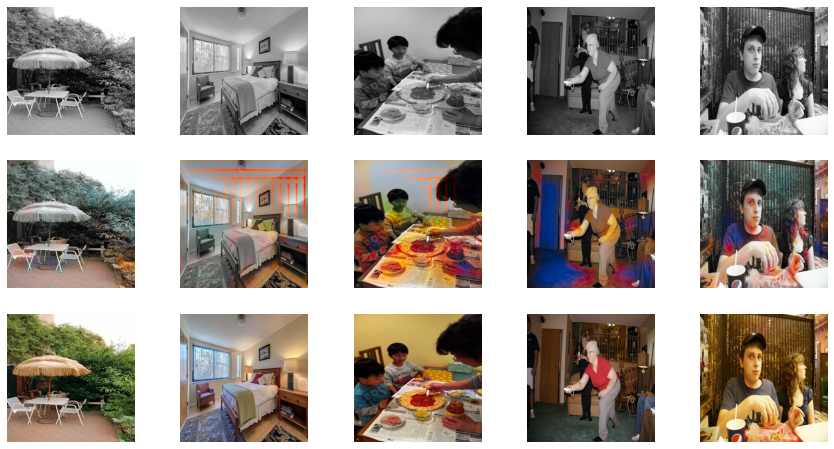


Epoch 3/100
Iteration 400/500
loss_D_fake: 0.50696
loss_D_real: 0.55432
loss_D: 0.53064
loss_G_GAN: 1.38504
loss_G_L1: 10.93779
loss_G: 12.32283


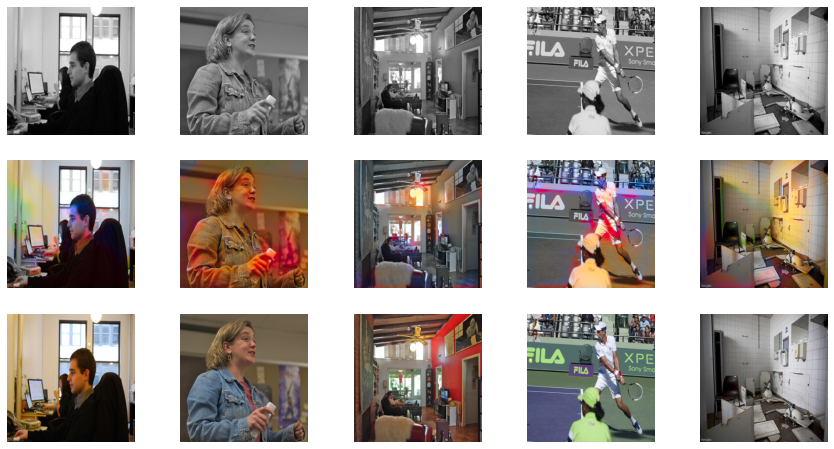

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 4/100
Iteration 200/500
loss_D_fake: 0.51438
loss_D_real: 0.58403
loss_D: 0.54920
loss_G_GAN: 1.26888
loss_G_L1: 10.88259
loss_G: 12.15146


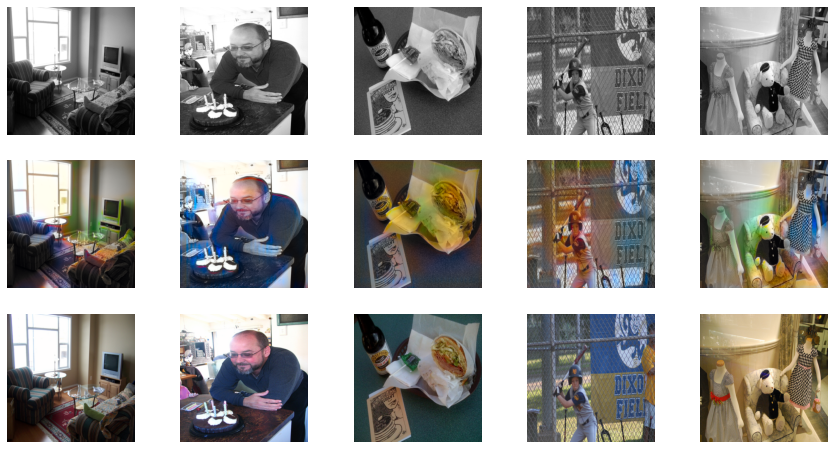


Epoch 4/100
Iteration 400/500
loss_D_fake: 0.52010
loss_D_real: 0.59029
loss_D: 0.55520
loss_G_GAN: 1.24643
loss_G_L1: 10.84210
loss_G: 12.08853


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


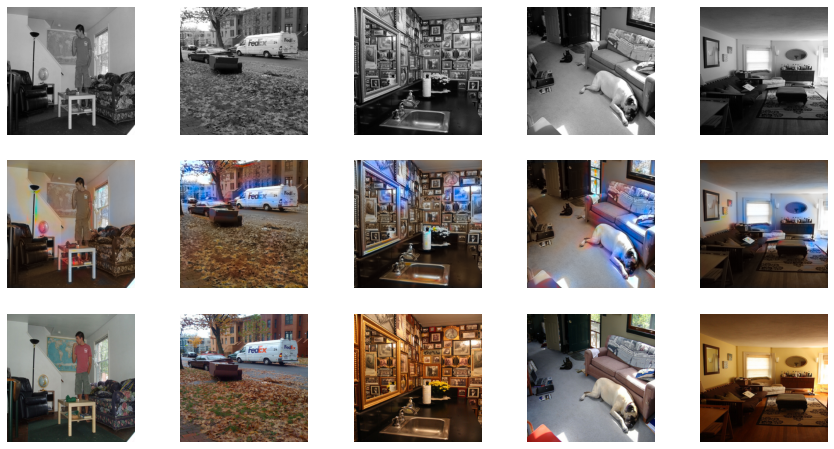

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 5/100
Iteration 200/500
loss_D_fake: 0.52984
loss_D_real: 0.60786
loss_D: 0.56885
loss_G_GAN: 1.21875
loss_G_L1: 10.85445
loss_G: 12.07320


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 57 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 39 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color

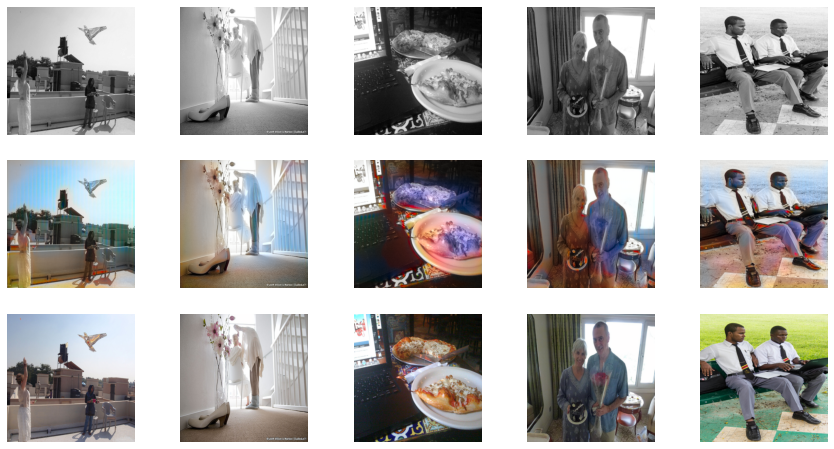


Epoch 5/100
Iteration 400/500
loss_D_fake: 0.52747
loss_D_real: 0.59739
loss_D: 0.56243
loss_G_GAN: 1.20985
loss_G_L1: 10.85368
loss_G: 12.06353


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 80 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


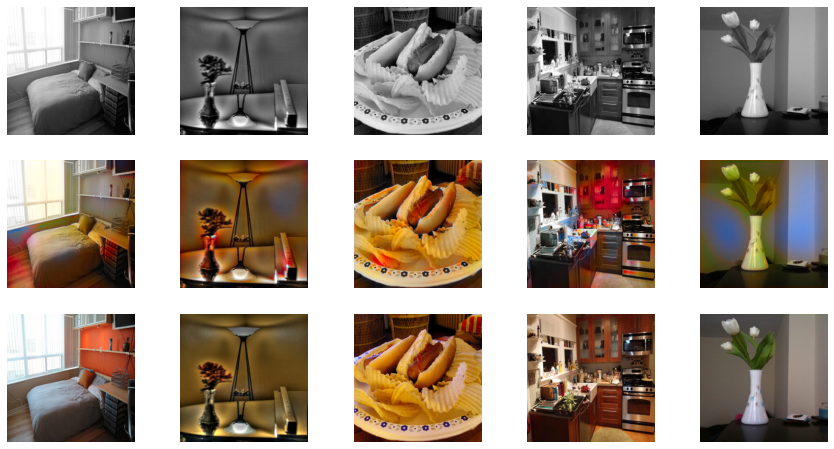

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 6/100
Iteration 200/500
loss_D_fake: 0.50555
loss_D_real: 0.56712
loss_D: 0.53634
loss_G_GAN: 1.28783
loss_G_L1: 11.10207
loss_G: 12.38990


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


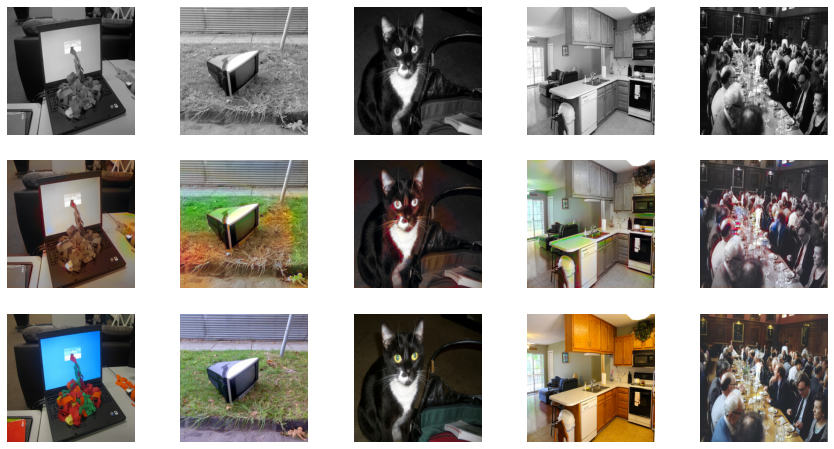


Epoch 6/100
Iteration 400/500
loss_D_fake: 0.52336
loss_D_real: 0.59486
loss_D: 0.55911
loss_G_GAN: 1.24984
loss_G_L1: 11.00071
loss_G: 12.25055


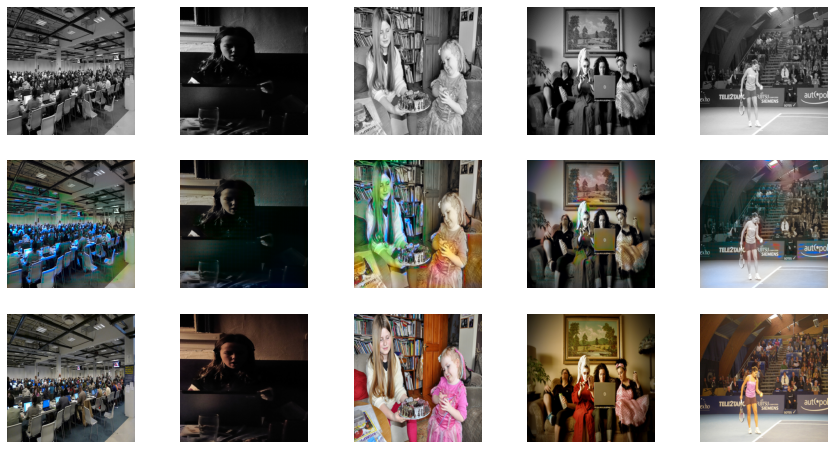

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 7/100
Iteration 200/500
loss_D_fake: 0.52406
loss_D_real: 0.58632
loss_D: 0.55519
loss_G_GAN: 1.19976
loss_G_L1: 10.89487
loss_G: 12.09463


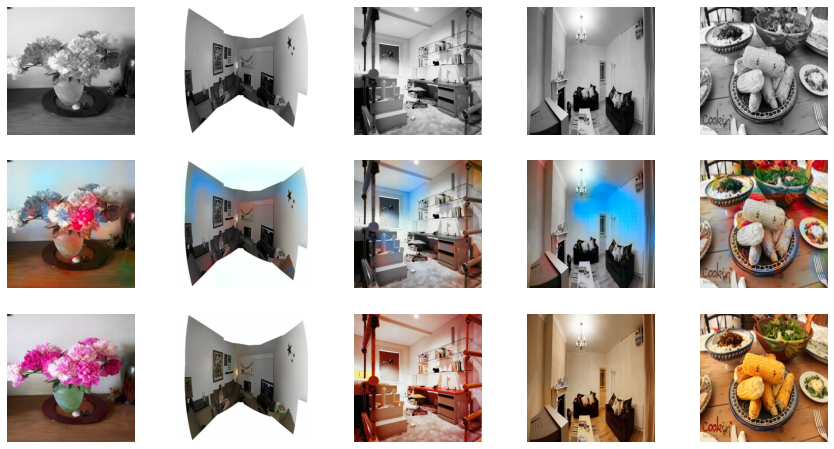


Epoch 7/100
Iteration 400/500
loss_D_fake: 0.52788
loss_D_real: 0.59415
loss_D: 0.56101
loss_G_GAN: 1.20968
loss_G_L1: 10.93356
loss_G: 12.14325


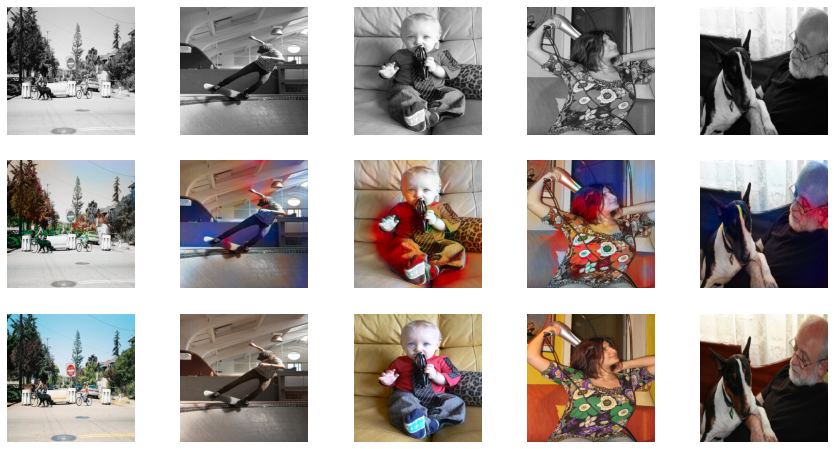

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 8/100
Iteration 200/500
loss_D_fake: 0.53221
loss_D_real: 0.60229
loss_D: 0.56725
loss_G_GAN: 1.19730
loss_G_L1: 10.98438
loss_G: 12.18168


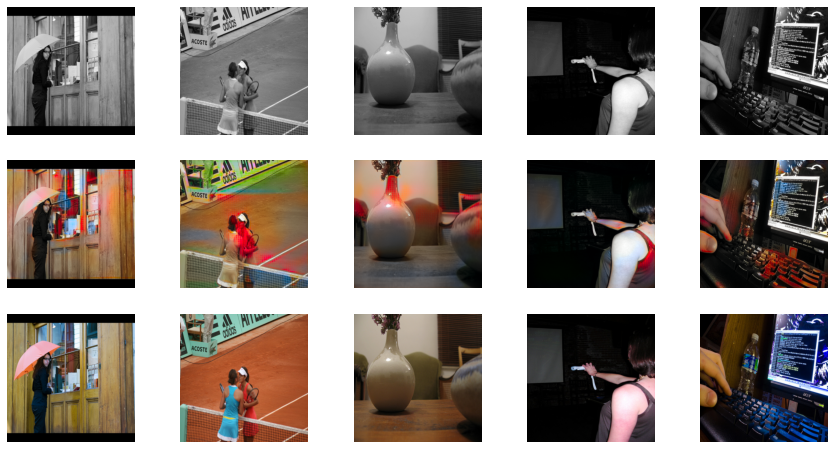


Epoch 8/100
Iteration 400/500
loss_D_fake: 0.53007
loss_D_real: 0.61085
loss_D: 0.57046
loss_G_GAN: 1.18761
loss_G_L1: 10.90885
loss_G: 12.09645


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 23 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 51 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


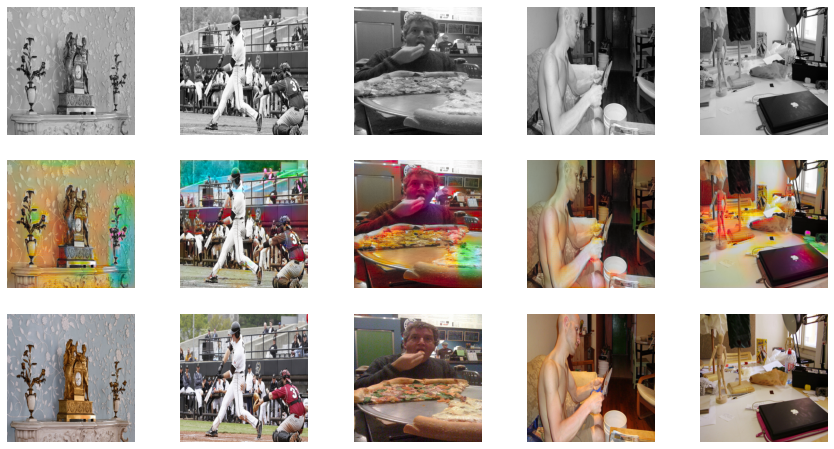

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 9/100
Iteration 200/500
loss_D_fake: 0.53105
loss_D_real: 0.60651
loss_D: 0.56878
loss_G_GAN: 1.18583
loss_G_L1: 10.99679
loss_G: 12.18262


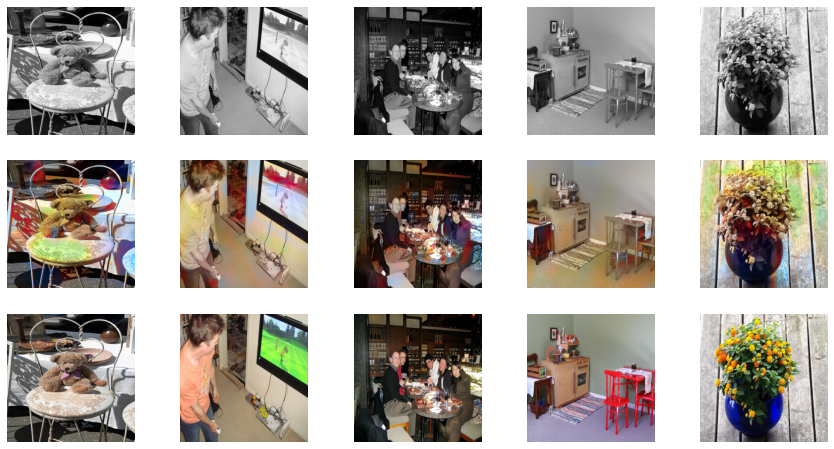


Epoch 9/100
Iteration 400/500
loss_D_fake: 0.53535
loss_D_real: 0.60528
loss_D: 0.57032
loss_G_GAN: 1.17317
loss_G_L1: 10.90073
loss_G: 12.07390


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


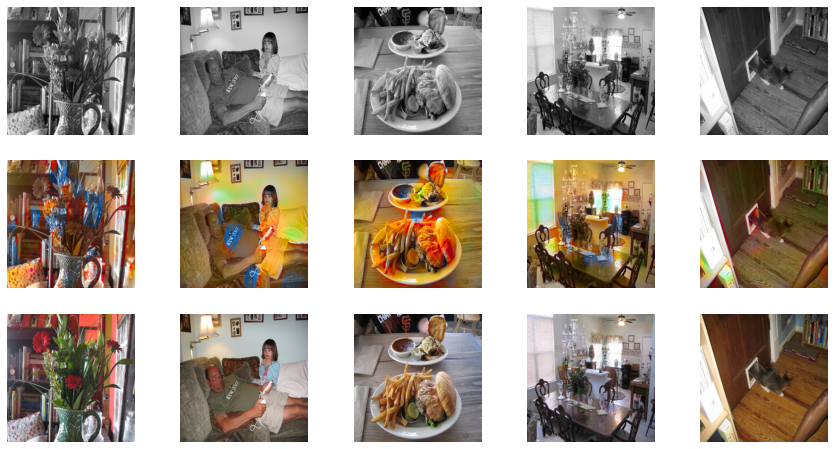

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 10/100
Iteration 200/500
loss_D_fake: 0.53075
loss_D_real: 0.59300
loss_D: 0.56188
loss_G_GAN: 1.17336
loss_G_L1: 10.75152
loss_G: 11.92488


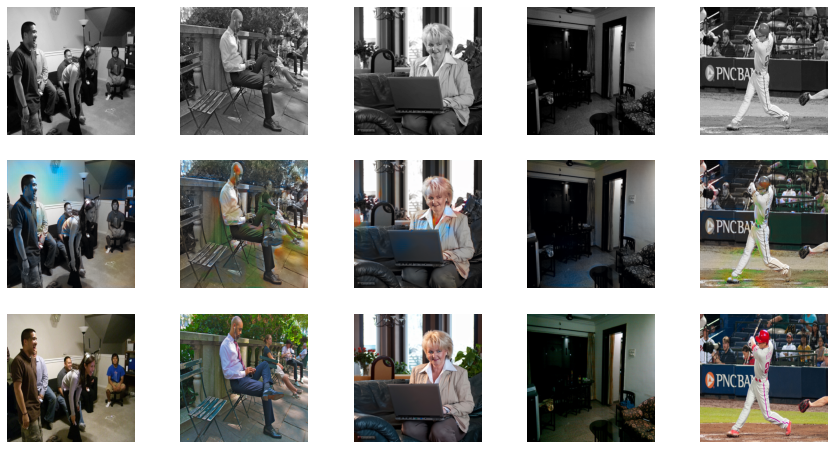


Epoch 10/100
Iteration 400/500
loss_D_fake: 0.53169
loss_D_real: 0.59203
loss_D: 0.56186
loss_G_GAN: 1.17956
loss_G_L1: 10.81876
loss_G: 11.99832


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 58 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


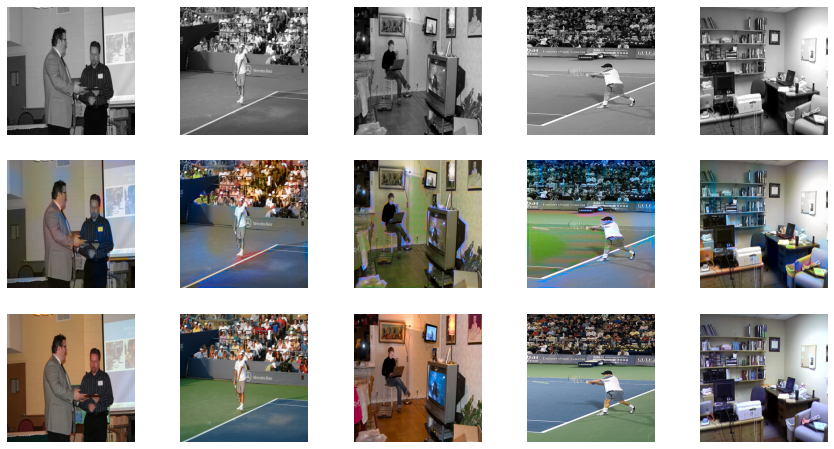

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 11/100
Iteration 200/500
loss_D_fake: 0.53906
loss_D_real: 0.58957
loss_D: 0.56431
loss_G_GAN: 1.15895
loss_G_L1: 10.64440
loss_G: 11.80335


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2138 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2202 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 626 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1427 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


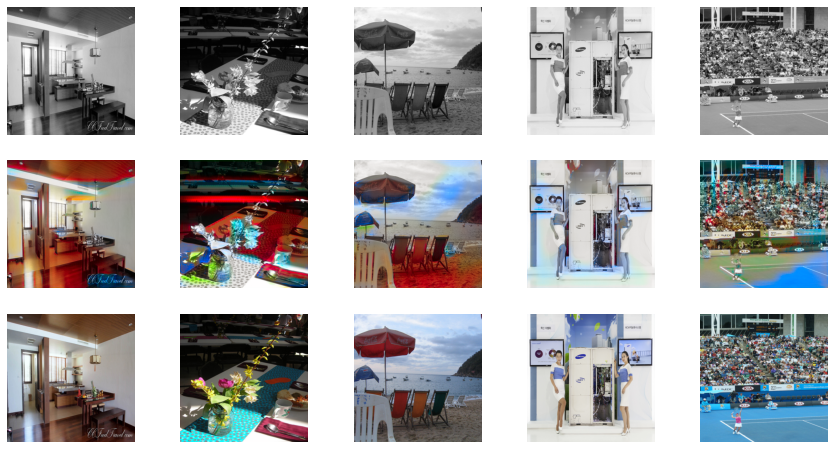


Epoch 11/100
Iteration 400/500
loss_D_fake: 0.53563
loss_D_real: 0.59489
loss_D: 0.56526
loss_G_GAN: 1.15908
loss_G_L1: 10.69123
loss_G: 11.85030


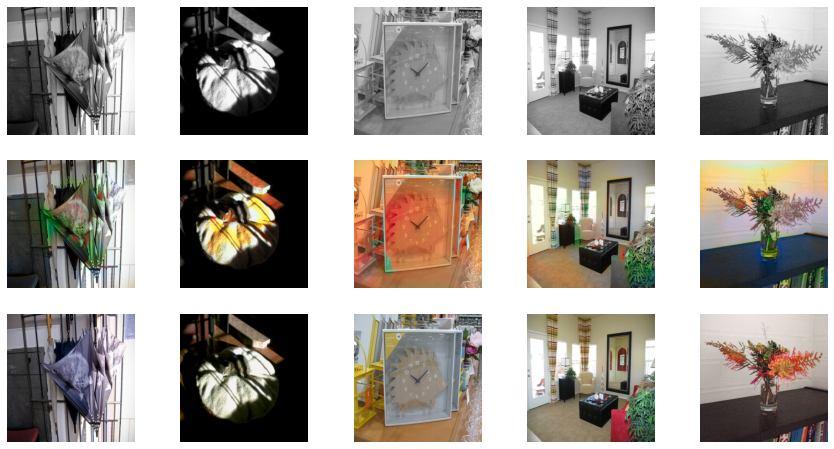

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 12/100
Iteration 200/500
loss_D_fake: 0.54492
loss_D_real: 0.59468
loss_D: 0.56980
loss_G_GAN: 1.16083
loss_G_L1: 10.76927
loss_G: 11.93011


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 30 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


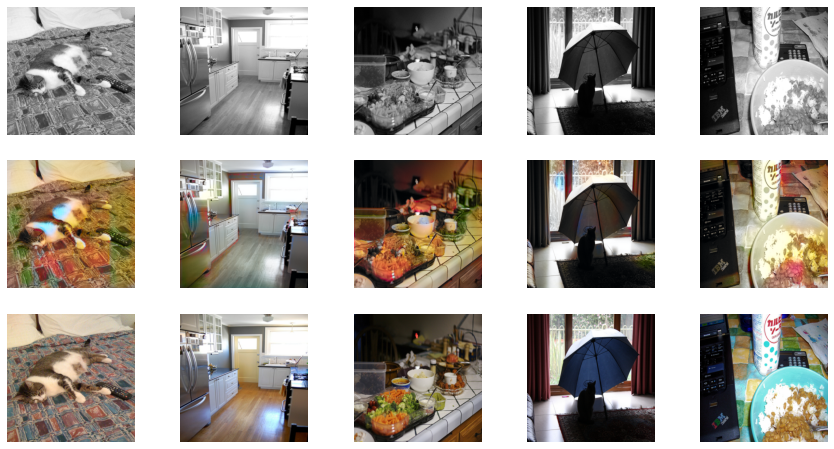


Epoch 12/100
Iteration 400/500
loss_D_fake: 0.53966
loss_D_real: 0.60235
loss_D: 0.57101
loss_G_GAN: 1.16790
loss_G_L1: 10.74901
loss_G: 11.91691


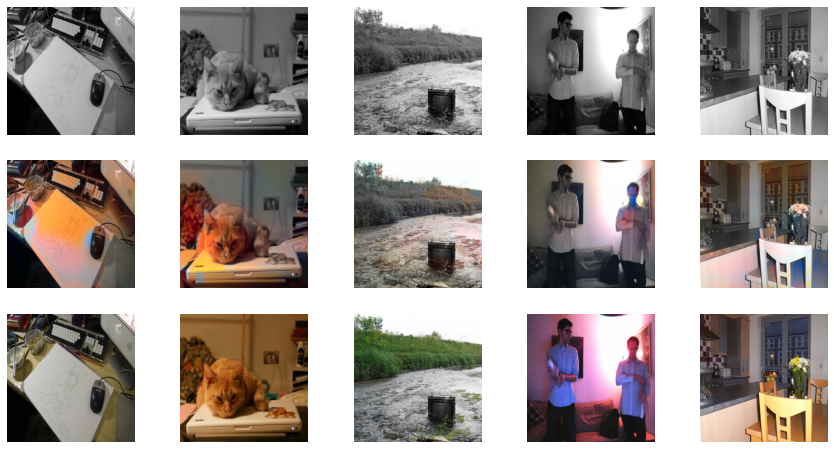

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 13/100
Iteration 200/500
loss_D_fake: 0.54032
loss_D_real: 0.60420
loss_D: 0.57226
loss_G_GAN: 1.14887
loss_G_L1: 10.65212
loss_G: 11.80099


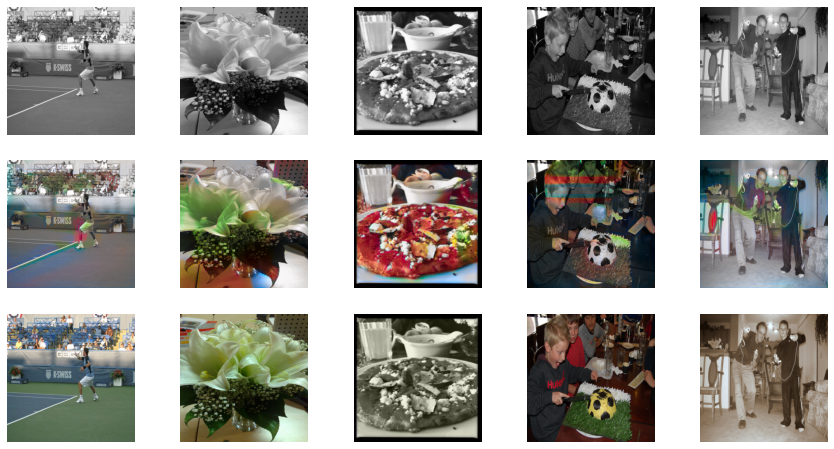


Epoch 13/100
Iteration 400/500
loss_D_fake: 0.53693
loss_D_real: 0.59876
loss_D: 0.56785
loss_G_GAN: 1.16928
loss_G_L1: 10.68983
loss_G: 11.85911


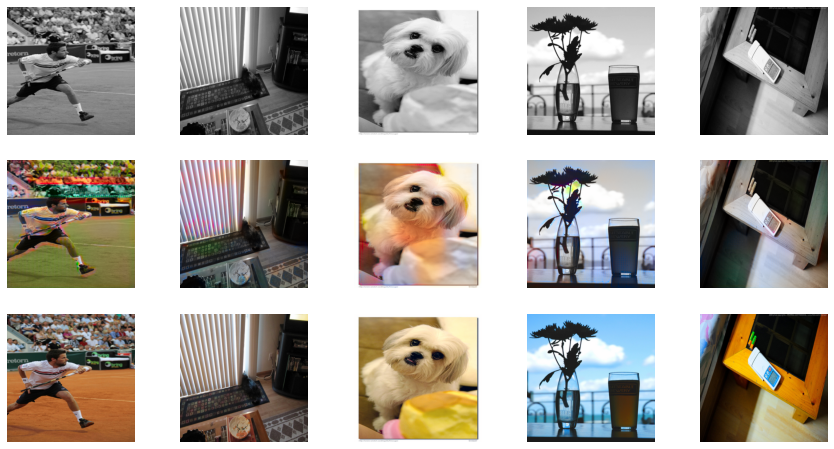

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 14/100
Iteration 200/500
loss_D_fake: 0.53493
loss_D_real: 0.60416
loss_D: 0.56955
loss_G_GAN: 1.16748
loss_G_L1: 10.80860
loss_G: 11.97608


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 46 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 36 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 61 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 22 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color

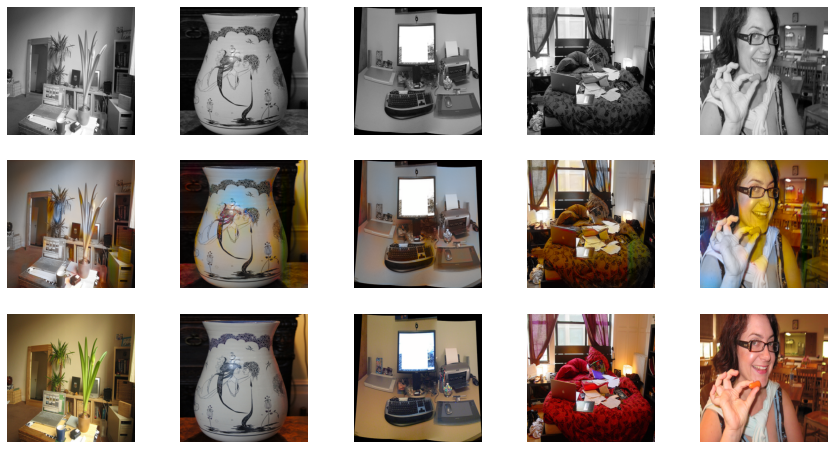


Epoch 14/100
Iteration 400/500
loss_D_fake: 0.53711
loss_D_real: 0.60813
loss_D: 0.57262
loss_G_GAN: 1.15115
loss_G_L1: 10.62694
loss_G: 11.77809


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


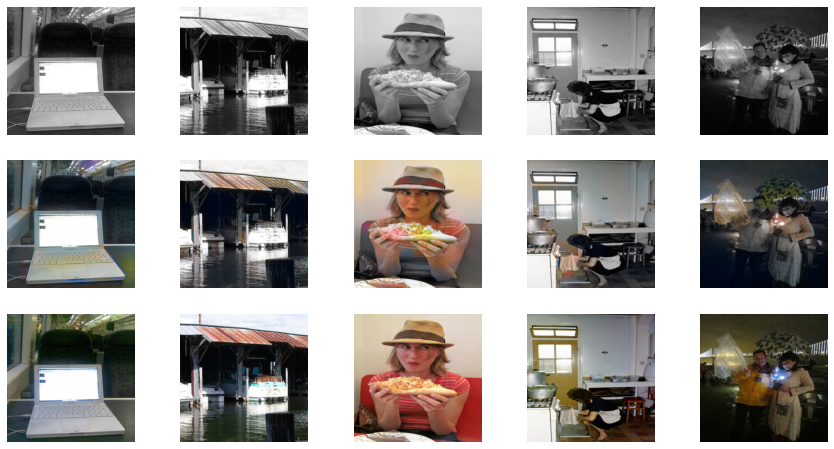

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 15/100
Iteration 200/500
loss_D_fake: 0.53268
loss_D_real: 0.59836
loss_D: 0.56552
loss_G_GAN: 1.17579
loss_G_L1: 10.52458
loss_G: 11.70037


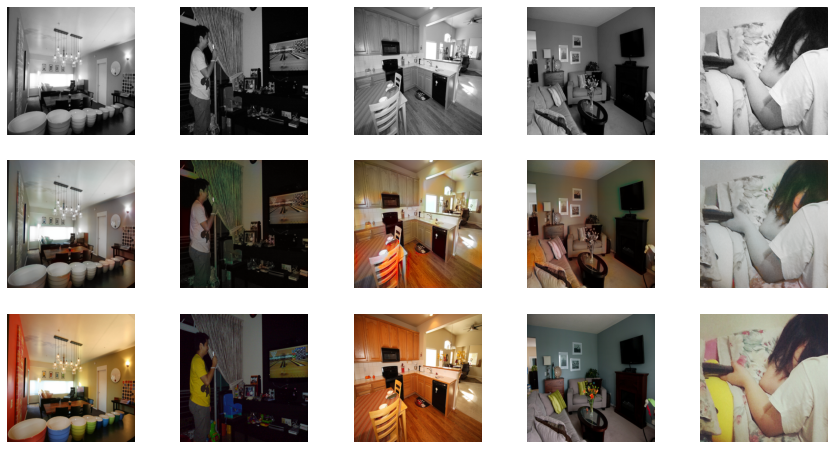


Epoch 15/100
Iteration 400/500
loss_D_fake: 0.53417
loss_D_real: 0.60045
loss_D: 0.56731
loss_G_GAN: 1.17224
loss_G_L1: 10.57308
loss_G: 11.74532


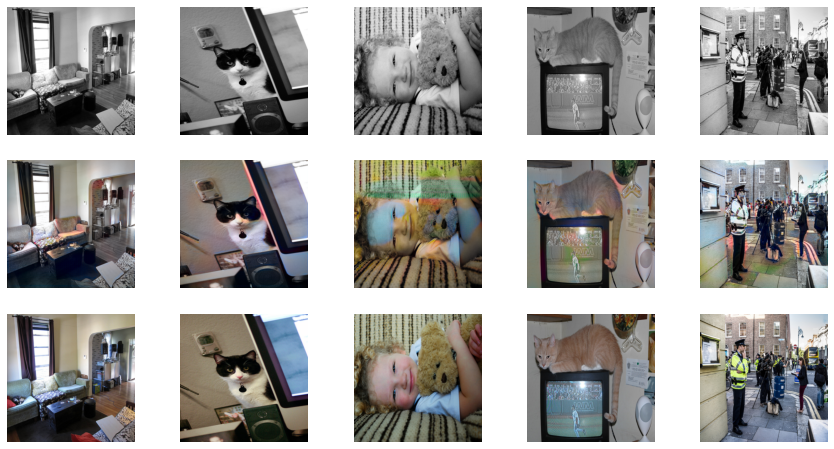

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 16/100
Iteration 200/500
loss_D_fake: 0.53741
loss_D_real: 0.59831
loss_D: 0.56786
loss_G_GAN: 1.17661
loss_G_L1: 10.61013
loss_G: 11.78674


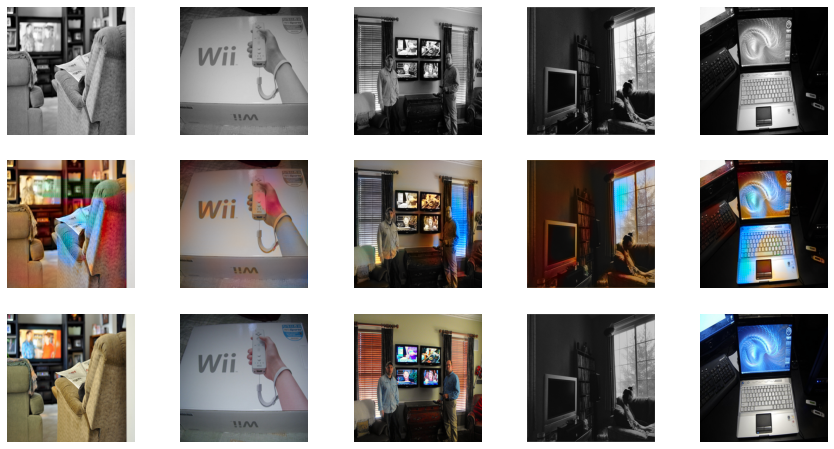


Epoch 16/100
Iteration 400/500
loss_D_fake: 0.53904
loss_D_real: 0.60997
loss_D: 0.57451
loss_G_GAN: 1.15294
loss_G_L1: 10.54289
loss_G: 11.69583


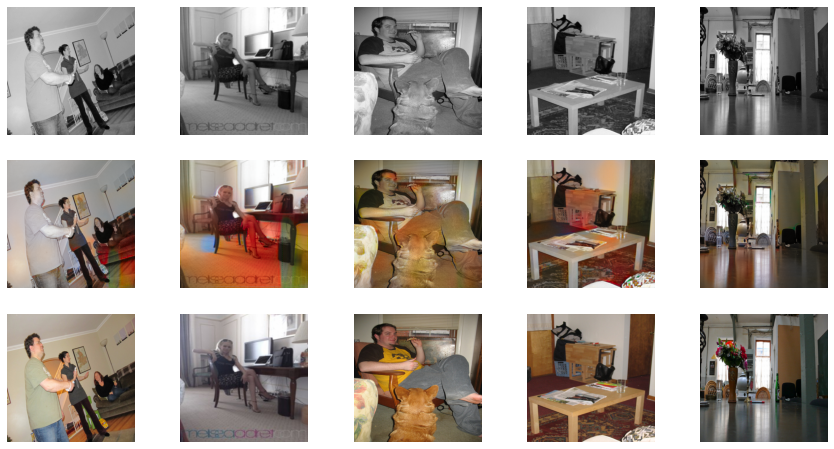

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 17/100
Iteration 200/500
loss_D_fake: 0.54393
loss_D_real: 0.60062
loss_D: 0.57227
loss_G_GAN: 1.15656
loss_G_L1: 10.40965
loss_G: 11.56621


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 870 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 42 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 632 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 904 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 833 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: C

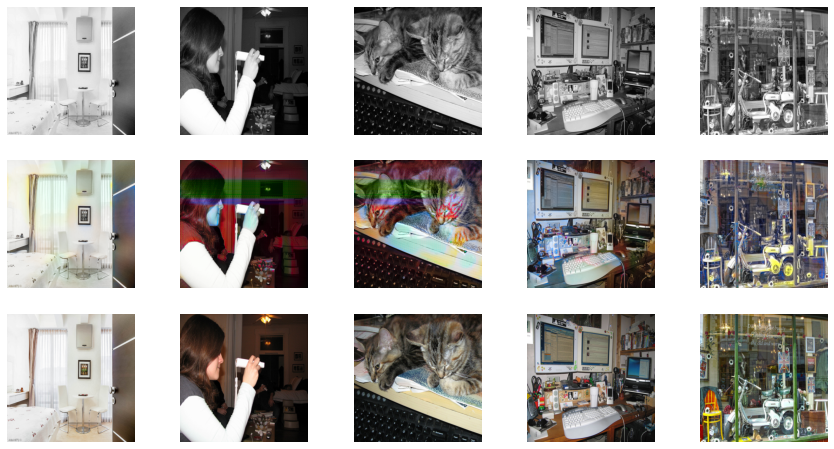


Epoch 17/100
Iteration 400/500
loss_D_fake: 0.54328
loss_D_real: 0.59571
loss_D: 0.56950
loss_G_GAN: 1.16054
loss_G_L1: 10.52333
loss_G: 11.68388


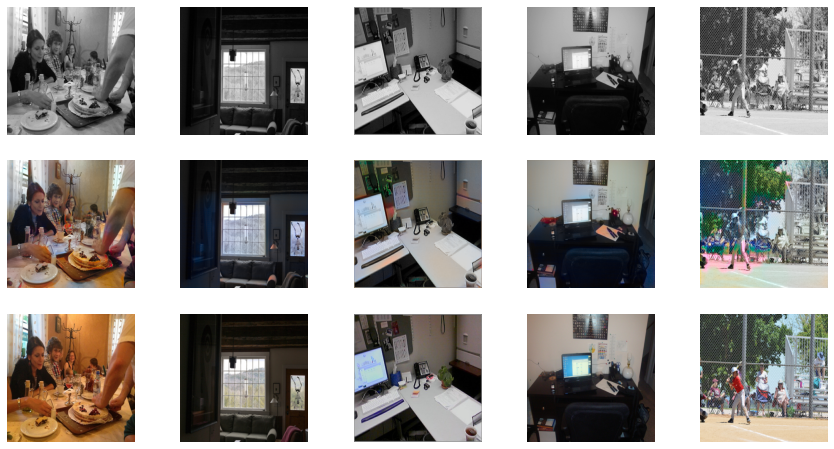

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 18/100
Iteration 200/500
loss_D_fake: 0.52749
loss_D_real: 0.60290
loss_D: 0.56520
loss_G_GAN: 1.13663
loss_G_L1: 10.45758
loss_G: 11.59421


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 47 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


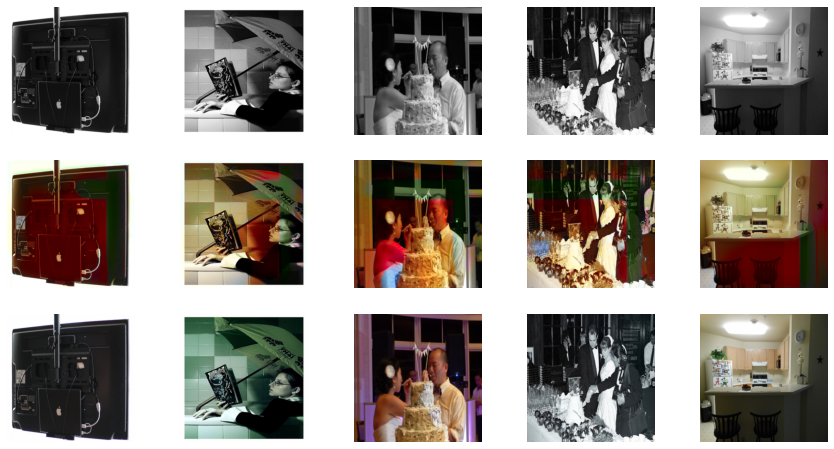


Epoch 18/100
Iteration 400/500
loss_D_fake: 0.54147
loss_D_real: 0.60239
loss_D: 0.57193
loss_G_GAN: 1.14610
loss_G_L1: 10.48964
loss_G: 11.63574


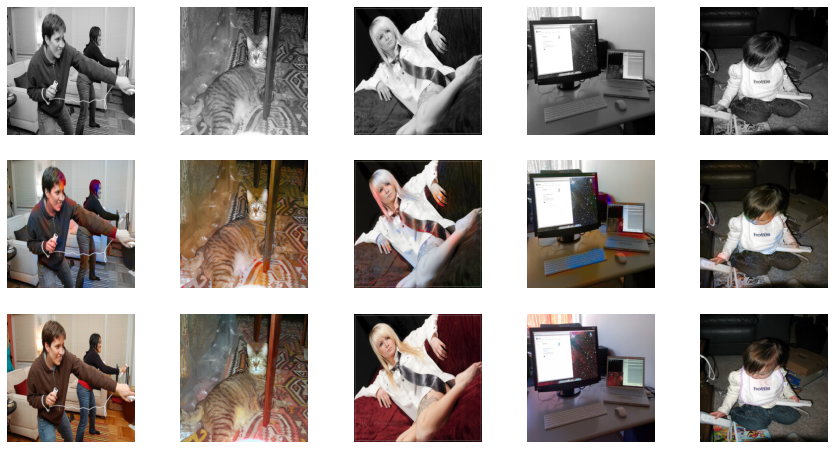

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 19/100
Iteration 200/500
loss_D_fake: 0.53369
loss_D_real: 0.59562
loss_D: 0.56466
loss_G_GAN: 1.15643
loss_G_L1: 10.53634
loss_G: 11.69277


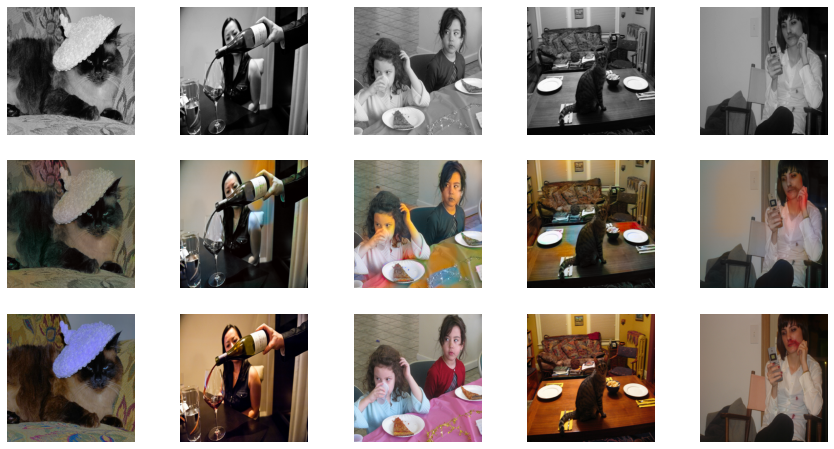


Epoch 19/100
Iteration 400/500
loss_D_fake: 0.53632
loss_D_real: 0.59627
loss_D: 0.56630
loss_G_GAN: 1.15019
loss_G_L1: 10.38990
loss_G: 11.54008


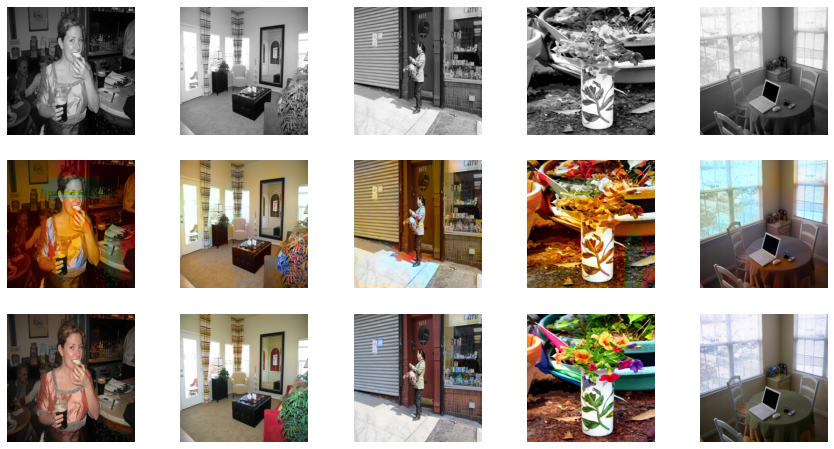

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 20/100
Iteration 200/500
loss_D_fake: 0.54166
loss_D_real: 0.60964
loss_D: 0.57565
loss_G_GAN: 1.15353
loss_G_L1: 10.49012
loss_G: 11.64365


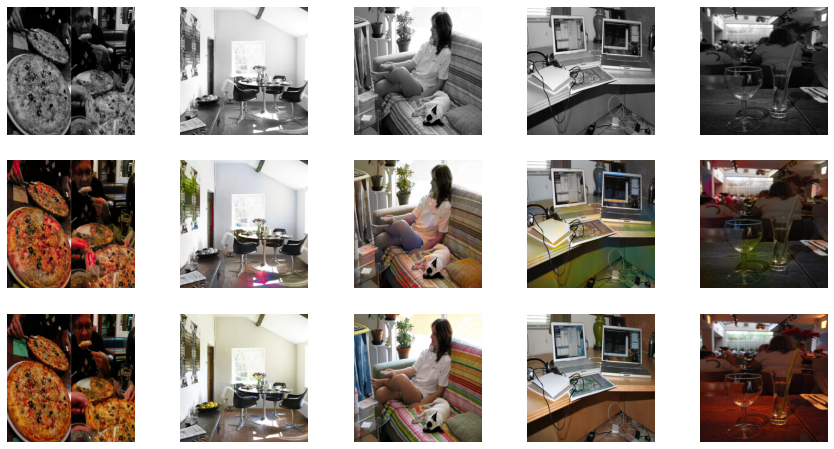


Epoch 20/100
Iteration 400/500
loss_D_fake: 0.54015
loss_D_real: 0.59689
loss_D: 0.56852
loss_G_GAN: 1.16211
loss_G_L1: 10.40574
loss_G: 11.56785


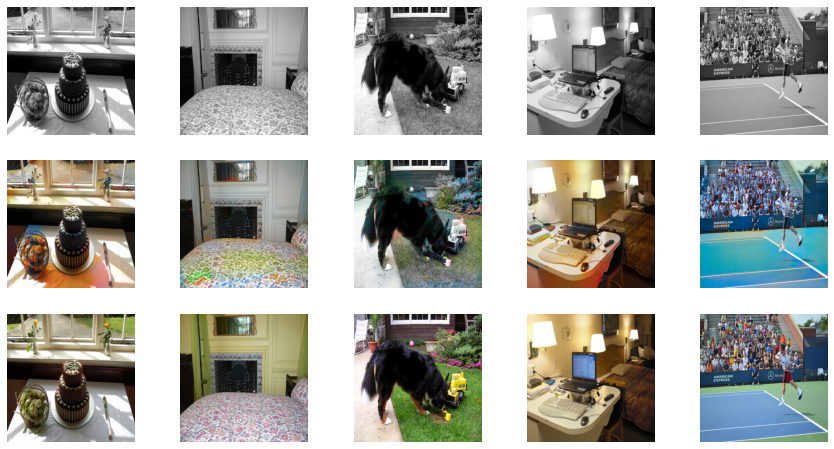

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 21/100
Iteration 200/500
loss_D_fake: 0.54633
loss_D_real: 0.58776
loss_D: 0.56705
loss_G_GAN: 1.15867
loss_G_L1: 10.37410
loss_G: 11.53276


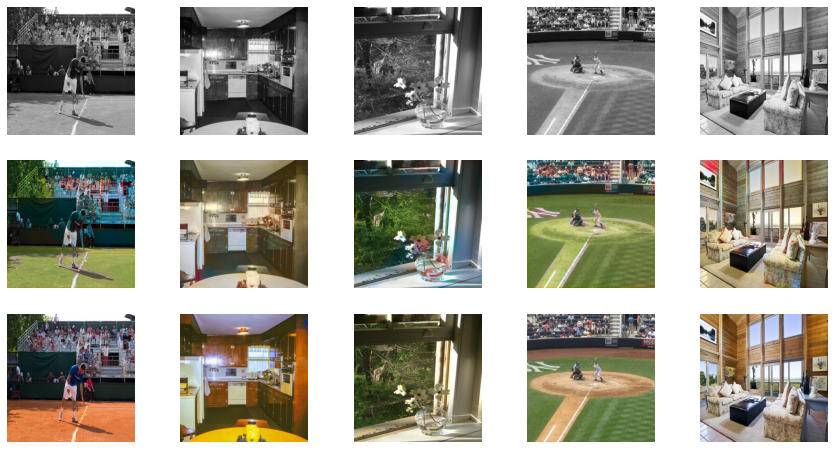


Epoch 21/100
Iteration 400/500
loss_D_fake: 0.54430
loss_D_real: 0.59292
loss_D: 0.56861
loss_G_GAN: 1.16002
loss_G_L1: 10.35721
loss_G: 11.51723


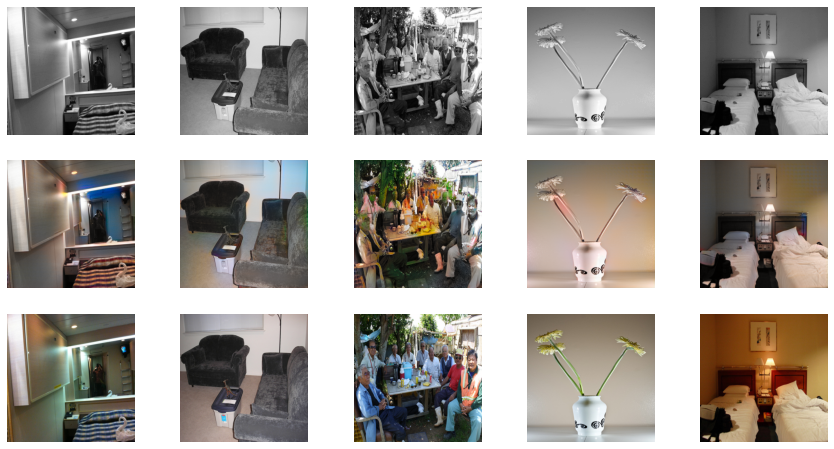

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 22/100
Iteration 200/500
loss_D_fake: 0.56103
loss_D_real: 0.58695
loss_D: 0.57399
loss_G_GAN: 1.16255
loss_G_L1: 10.34119
loss_G: 11.50373


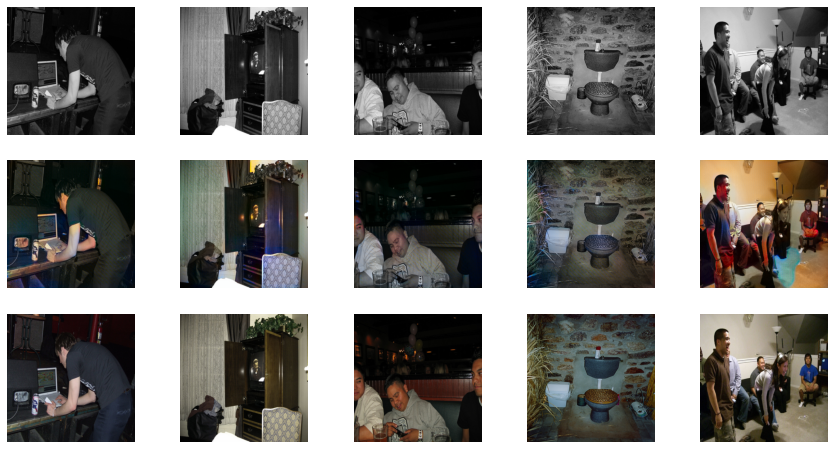


Epoch 22/100
Iteration 400/500
loss_D_fake: 0.54366
loss_D_real: 0.59158
loss_D: 0.56762
loss_G_GAN: 1.16804
loss_G_L1: 10.33035
loss_G: 11.49839


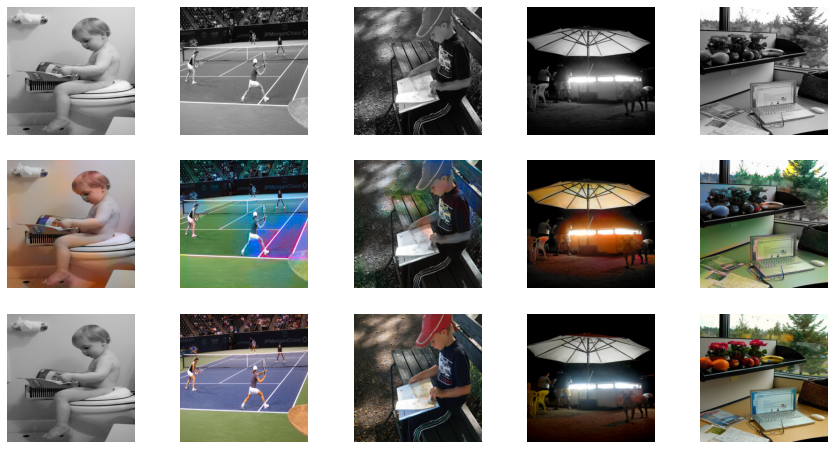

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 23/100
Iteration 200/500
loss_D_fake: 0.54156
loss_D_real: 0.61457
loss_D: 0.57807
loss_G_GAN: 1.14958
loss_G_L1: 10.20664
loss_G: 11.35622


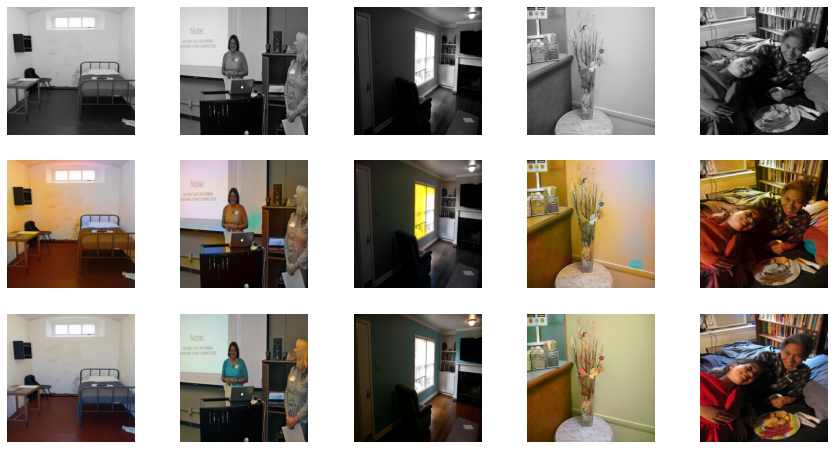


Epoch 23/100
Iteration 400/500
loss_D_fake: 0.54148
loss_D_real: 0.60388
loss_D: 0.57268
loss_G_GAN: 1.14496
loss_G_L1: 10.27923
loss_G: 11.42419


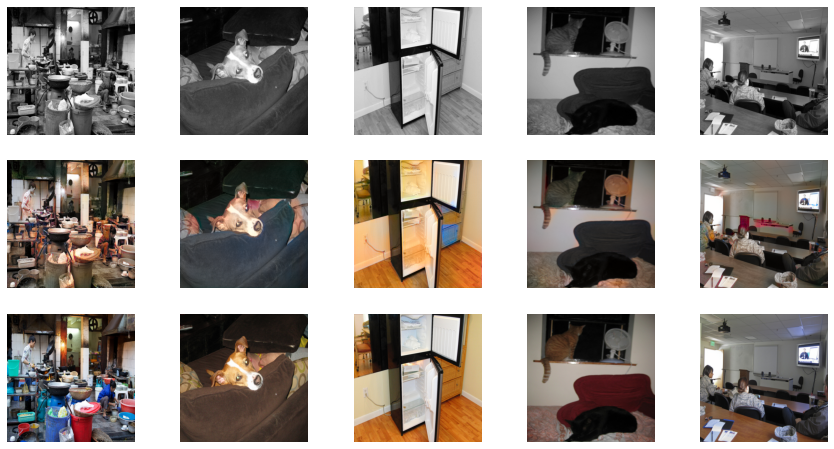

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 24/100
Iteration 200/500
loss_D_fake: 0.54513
loss_D_real: 0.59894
loss_D: 0.57204
loss_G_GAN: 1.14582
loss_G_L1: 10.32859
loss_G: 11.47441


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 29 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 53 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 357 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 40 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 37 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Colo

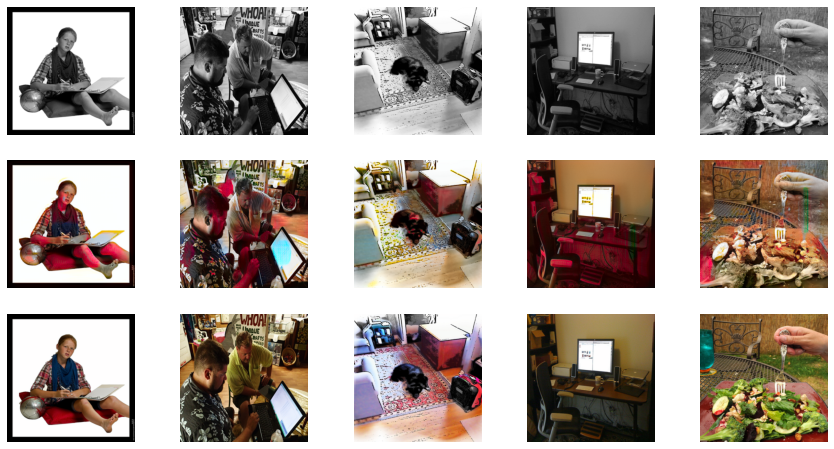


Epoch 24/100
Iteration 400/500
loss_D_fake: 0.54766
loss_D_real: 0.59697
loss_D: 0.57232
loss_G_GAN: 1.14966
loss_G_L1: 10.28969
loss_G: 11.43934


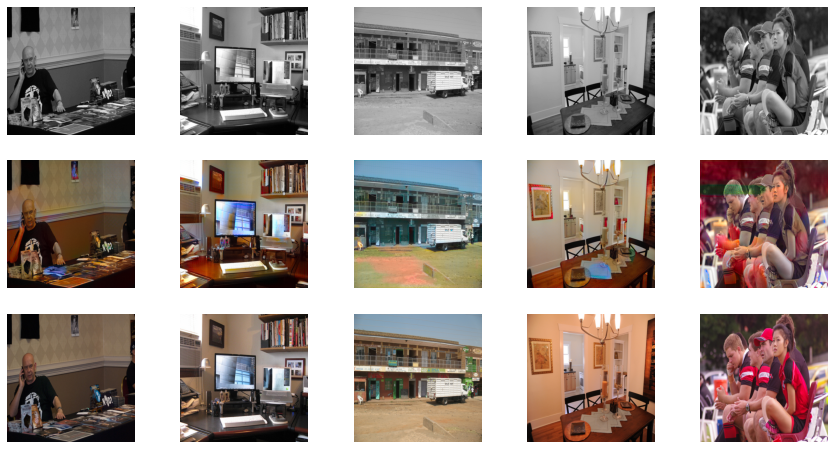

  0%|          | 0/500 [00:00<?, ?it/s]

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

path_g = "/content/gdrive/MyDrive/weights/generator.pt"
path_d = "/content/gdrive/MyDrive/weights/discriminator.pt"
path_go = "/content/gdrive/MyDrive/weights/generator_optimizer.pt"
path_do = "/content/gdrive/MyDrive/weights/discriminator_optimizer.pt"
path_losses = '/content/gdrive/MyDrive/weights/losses.txt'

net_G = build_res_unet(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res18-unet.pt", map_location="cuda"))
model = MainModel(net_G=net_G)
train_model(model, train_dataloader, 100, path_g, path_d, path_go, path_do, path_losses)

In [ ]:
torch.save(model.state_dict(), "model.pt")